## Imports 

In [1]:
print("\n... IMPORTS STARTING ...\n")

import pandas as pd 
import numpy as np 
import tensorflow as tf
import tensorflow_io as tfio

# Built In Imports
from kaggle_datasets import KaggleDatasets
from collections import Counter
from datetime import datetime
from glob import glob
import warnings
import requests
import hashlib
import imageio
import IPython
import sklearn
import urllib
import zipfile
import pickle
import random
import shutil
import string
import json
import math
import time
import gzip
import ast
import sys
import io
import os
import gc
import re

# Visualization Imports
from matplotlib.colors import ListedColormap
from matplotlib.patches import Rectangle
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm; tqdm.pandas();
import plotly.express as px
import seaborn as sns
from PIL import Image, ImageEnhance
import matplotlib; print(f"\t\t– MATPLOTLIB VERSION: {matplotlib.__version__}");
from matplotlib import animation, rc; rc('animation', html='jshtml')
import plotly
import PIL
import cv2

import plotly.io as pio
print(pio.renderers)

def seed_it_all(seed=7):
    """ Attempt to be Reproducible """
    os.environ['PYTHONHASHSEED'] = str(seed)
    random.seed(seed)
    np.random.seed(seed)

    
print("\n\n... IMPORTS COMPLETE ...\n")




... IMPORTS STARTING ...

		– MATPLOTLIB VERSION: 3.5.2
Renderers configuration
-----------------------
    Default renderer: 'kaggle'
    Available renderers:
        ['plotly_mimetype', 'jupyterlab', 'nteract', 'vscode',
         'notebook', 'notebook_connected', 'kaggle', 'azure', 'colab',
         'cocalc', 'databricks', 'json', 'png', 'jpeg', 'jpg', 'svg',
         'pdf', 'browser', 'firefox', 'chrome', 'chromium', 'iframe',
         'iframe_connected', 'sphinx_gallery', 'sphinx_gallery_png']



... IMPORTS COMPLETE ...



# BASIC DATA DEFINITIONS & INITIALIZATIONS

In [2]:
print("\n... BASIC DATA SETUP STARTING ...\n\n")

DATA_DIR = "/kaggle/input/hubmap-organ-segmentation"


# Open the training dataframe and display the initial dataframe
TRAIN_IMAGES_DIR = os.path.join(DATA_DIR, "train_images")
TRAIN_LABELS_DIR = os.path.join(DATA_DIR, "train_annotations")
TRAIN_CSV = os.path.join(DATA_DIR, "train.csv")
train_df = pd.read_csv(TRAIN_CSV)

# Get all training images
all_train_images = glob(os.path.join(TRAIN_IMAGES_DIR, "*.tiff"), recursive=True)
all_train_labels = glob(os.path.join(TRAIN_LABELS_DIR, "*.json"), recursive=True)

print("\n... ORIGINAL TRAINING DATAFRAME... \n")
display(train_df)

TEST_IMAGES_DIR = os.path.join(DATA_DIR, "test_images")
TEST_CSV = os.path.join(DATA_DIR, "test.csv")
test_df = pd.read_csv(TEST_CSV)

SS_CSV   = os.path.join(DATA_DIR, "sample_submission.csv")
ss_df = pd.read_csv(SS_CSV)

# Get all testing images if there are any
all_test_images = glob(os.path.join(TEST_IMAGES_DIR, "*.tiff"), recursive=True)

print("\n\n\n... ORIGINAL SUBMISSION DATAFRAME... \n")
display(ss_df.head())

DEBUG=len(ss_df)==0 

def rgb2hex(rgb_tuple):
    r,g,b = rgb_tuple
    def clamp(x): 
        return max(0, min(x, 255))
    return "#{0:02x}{1:02x}{2:02x}".format(clamp(r), clamp(g), clamp(b))
ORGANS = ['kidney', 'largeintestine', 'lung', 'prostate', 'spleen']
_COLOURS = [(230, 0, 73), (11, 180, 255), (80, 233, 145), (230, 216, 0), (155, 25, 245)]
O2C_MAP = {_o:_c for _o,_c in zip(ORGANS, _COLOURS)}
O2C_HEX_MAP = {_o:rgb2hex(_c) for _o,_c in O2C_MAP.items()}

print(f"\n\n\n... ARE WE DEBUGGING: {DEBUG}... \n")

print("\n... BASIC DATA SETUP FINISHED ...\n\n")


... BASIC DATA SETUP STARTING ...



... ORIGINAL TRAINING DATAFRAME... 



,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,37.0,Male
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,76.0,Male
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,82.0,Male
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,78.0,Male
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,21.0,Female
...,...,...,...,...,...,...,...,...,...,...
346,9517,kidney,HPA,3000,3000,0.4,4,1611763 11 1614753 29 1617750 35 1620746 43 16...,61.0,Male
347,9769,kidney,HPA,3070,3070,0.4,4,4030400 28 4033466 34 4036526 48 4039594 54 40...,28.0,Male
348,9777,largeintestine,HPA,3000,3000,0.4,4,538473 13 541468 22 544463 30 547461 35 550459...,84.0,Male
349,9791,kidney,HPA,3000,3000,0.4,4,334733 33 337729 43 340729 43 343725 51 346723...,28.0,Male





... ORIGINAL SUBMISSION DATAFRAME... 



,id,rle
0,10078,12 34





... ARE WE DEBUGGING: False... 


... BASIC DATA SETUP FINISHED ...




# UPDATE DATAFRAMES WITH ACCESSIBLE EXTRA INFORMATION

---

We wrapped the logic in a preprocessing function but also went through step by step so people could validate if they so wished



In [3]:
sex_2_int = {"Male":0, "Female":1}
int_2_sex = {v:k for k,v in sex_2_int.items()}
age_divisor = 100.0

train_df["sex"] = train_df["sex"].map(sex_2_int)
train_df["age"] = train_df["age"]/age_divisor
train_df.head()

,id,organ,data_source,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,0.37,0
1,10274,prostate,HPA,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,0.76,0
2,10392,spleen,HPA,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,0.82,0
3,10488,lung,HPA,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,0.78,0
4,10610,spleen,HPA,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,0.21,1


In [4]:
train_img_map = {int(x[:-5].rsplit("/", 1)[-1]):x for x in all_train_images}
train_lbl_map = {int(x[:-5].rsplit("/", 1)[-1]):x for x in all_train_labels}
test_img_map = {int(x[:-5].rsplit("/", 1)[-1]):x for x in all_test_images}

train_df.insert(3, "img_path", train_df["id"].map(train_img_map))
train_df.insert(4, "lbl_path", train_df["id"].map(train_lbl_map))
test_df.insert(3, "img_path", test_df["id"].map(test_img_map))

train_df.head()

,id,organ,data_source,img_path,lbl_path,img_height,img_width,pixel_size,tissue_thickness,rle,age,sex
0,10044,prostate,HPA,/kaggle/input/hubmap-organ-segmentation/train_...,/kaggle/input/hubmap-organ-segmentation/train_...,3000,3000,0.4,4,1459676 77 1462675 82 1465674 87 1468673 92 14...,0.37,0
1,10274,prostate,HPA,/kaggle/input/hubmap-organ-segmentation/train_...,/kaggle/input/hubmap-organ-segmentation/train_...,3000,3000,0.4,4,715707 2 718705 8 721703 11 724701 18 727692 3...,0.76,0
2,10392,spleen,HPA,/kaggle/input/hubmap-organ-segmentation/train_...,/kaggle/input/hubmap-organ-segmentation/train_...,3000,3000,0.4,4,1228631 20 1231629 24 1234624 40 1237623 47 12...,0.82,0
3,10488,lung,HPA,/kaggle/input/hubmap-organ-segmentation/train_...,/kaggle/input/hubmap-organ-segmentation/train_...,3000,3000,0.4,4,3446519 15 3449517 17 3452514 20 3455510 24 34...,0.78,0
4,10610,spleen,HPA,/kaggle/input/hubmap-organ-segmentation/train_...,/kaggle/input/hubmap-organ-segmentation/train_...,3000,3000,0.4,4,478925 68 481909 87 484893 105 487863 154 4908...,0.21,1


# Helper Functions

In [5]:
# ref: https://www.kaggle.com/paulorzp/run-length-encode-and-decode
# modified from: https://www.kaggle.com/inversion/run-length-decoding-quick-start

def rle_decode(mask_rle, shape, color=1):
    """ TBD
    
    Args:
        mask_rle (str): run-length as string formated (start length)
        shape (tuple of ints): (height,width) of array to return 
    
    Returns: 
        Mask (np.array)
            - 1 indicating mask
            - 0 indicating background

    """
    # Split the string by space, then convert it into a integer array
    s = np.array(mask_rle.split(), dtype=int)

    # Every even value is the start, every odd value is the "run" length
    starts = s[0::2] - 1
    lengths = s[1::2]
    ends = starts + lengths

    # The image image is actually flattened since RLE is a 1D "run"
    if len(shape)==3:
        h, w, d = shape
        img = np.zeros((h * w, d), dtype=np.float32)
    else:
        h, w = shape
        img = np.zeros((h * w,), dtype=np.float32)

    # The color here is actually just any integer you want!
    for lo, hi in zip(starts, ends):
        img[lo : hi] = color
        
    # Don't forget to change the image back to the original shape
    return img.reshape(shape).T

# https://www.kaggle.com/namgalielei/which-reshape-is-used-in-rle
def rle_decode_top_to_bot_first(mask_rle, shape):
    """ TBD
    
    Args:
        mask_rle (str): run-length as string formated (start length)
        shape (tuple of ints): (height,width) of array to return 
    
    Returns:
        Mask (np.array)
            - 1 indicating mask
            - 0 indicating background

    """
    s = mask_rle.split()
    starts, lengths = [np.asarray(x, dtype=int) for x in (s[0:][::2], s[1:][::2])]
    starts -= 1
    ends = starts + lengths
    img = np.zeros(shape[0]*shape[1], dtype=np.uint8)
    for lo, hi in zip(starts, ends):
        img[lo:hi] = 1
    return img.reshape((shape[1], shape[0]), order='F').T  # Reshape from top -> bottom first

# ref.: https://www.kaggle.com/stainsby/fast-tested-rle
def rle_encode(img):
    """ TBD
    
    Args:
        img (np.array): 
            - 1 indicating mask
            - 0 indicating background
    
    Returns: 
        run length as string formated
    """
    pixels = img.T.flatten()
    pixels = np.concatenate([[0], pixels, [0]])
    runs = np.where(pixels[1:] != pixels[:-1])[0] + 1
    runs[1::2] -= runs[::2]
    return ' '.join(str(x) for x in runs)

def flatten_l_o_l(nested_list):
    """ Flatten a list of lists """
    return [item for sublist in nested_list for item in sublist]

def load_json_to_dict(json_path):
    """ tbd """
    with open(json_path) as json_file:
        data = json.load(json_file)
    return data

def tf_decode_tiff(img_path, to_numpy=False, to_rgb=False):
    img = tf.io.read_file(img_path)
    img = tfio.experimental.image.decode_tiff(img)
    
    # Optionals
    if to_rgb: img = tfio.experimental.color.rgba_to_rgb(img)
    if to_numpy: img = img.numpy()
        
    return img

# Data Exploration

## LOOK AT A SINGLE EXAMPLE PRIOR TO INVESTIGATION
___

We simply do this to make sure everything is where it should be and we understand the basics of how to access all the relevant data.

We will wrap this basic exploration functionality as single function to allow for easy examination of any passed identifier

In [6]:
def get_overlay(img_path, organ, rle_str, img_shape, _alpha=0.999, _beta=0.35, _gamma=0):
    _img = tf_decode_tiff(img_path, to_numpy=True, to_rgb=True).astype(np.float32)
    _seg_rgb = (np.stack([rle_decode(rle_str, shape=img_shape, color=1),]*3, axis=-1)*O2C_MAP[organ]).astype(np.float32)
    seg_overlay = cv2.addWeighted(src1=_img, alpha=_alpha, 
                                  src2=_seg_rgb, beta=_beta, gamma=_gamma)
    return seg_overlay/255.

def examine_id(df, ex_id=None, plot_overlay=True, print_meta=True, plot_original=False, plot_segmentation=False, _figsize=(20,20)):
    """ Wrapper function to allow for easy visual exploration of an example """
    if ex_id is None:
        ex_id = df["id"].sample(1).values[0]
        print(f"\n... NO ID GIVEN... RANDOM ID CHOSEN: ID={ex_id} ...")
    
    print(f"\n... ID ({ex_id}) EXPLORATION STARTED ...\n\n")
    demo_ex = df[df["id"]==ex_id].squeeze()

    if print_meta:
        print(f"\n... WITH id=`{ex_id}` (organ=`{demo_ex['organ']}`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... \n\n")
        display(demo_ex.to_frame())

    if plot_original:
        print(f"\n\n... ORIGINAL IMAGE PLOT ...\n")
        plt.figure(figsize=_figsize)
        plt.imshow(tf_decode_tiff(demo_ex["img_path"], to_numpy=True, to_rgb=True))
        plt.title(f"Original RGB Image For ID: {ex_id}", fontweight="bold")
        plt.axis(False)
        plt.show()

    if plot_segmentation:
        print(f"\n\n... SEGMENTATION MASK PLOT ({demo_ex['organ']})...\n")
        plt.figure(figsize=_figsize)
        plt.imshow((np.stack([rle_decode(demo_ex.rle, shape=(demo_ex.img_width, demo_ex.img_height), color=1),]*3, axis=-1)*O2C_MAP[demo_ex.organ]).astype(np.float32))
        plt.title(f"Segmentation Mask ({demo_ex.organ})", fontweight="bold")
        plt.axis(False)
        plt.show()

    if plot_overlay:
        print(f"\n\n... IMAGE WITH RGB SEGMENTATION MASK OVERLAY ({demo_ex['organ']}) ...\n")
        seg_overlay = get_overlay(demo_ex.img_path, demo_ex.organ, demo_ex.rle, img_shape=(demo_ex.img_width, demo_ex.img_height))

        plt.figure(figsize=_figsize)
        plt.imshow(seg_overlay)
        plt.title(f"Segmentation Overlay id=`{ex_id}` (organ=`{demo_ex['organ']}`)", fontweight="bold")
        handles = [Rectangle((0,0),1,1, color=(*[__c/255. for __c in _c], 0.5)) for _c in _COLOURS]
        labels = ORGANS
        plt.legend(handles,labels)
        plt.axis(False)
        plt.show()

    print("\n\n... SINGLE ID EXPLORATION FINISHED ...\n\n")



... RANDOM KIDNEY TRAIN EXAMPLE ...



... NO ID GIVEN... RANDOM ID CHOSEN: ID=30194 ...

... ID (30194) EXPLORATION STARTED ...



... WITH id=`30194` (organ=`kidney`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,231
id,30194
organ,kidney
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,3000
img_width,3000
pixel_size,0.4
tissue_thickness,4
rle,860063 29 863061 33 866059 37 869058 39 872058...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (kidney) ...



2022-09-14 16:05:59.049981: I tensorflow/core/common_runtime/process_util.cc:146] Creating new thread pool with default inter op setting: 2. Tune using inter_op_parallelism_threads for best performance.
2022-09-14 16:05:59.683220: I tensorflow_io/core/kernels/cpu_check.cc:128] Your CPU supports instructions that this TensorFlow IO binary was not compiled to use: AVX2 FMA


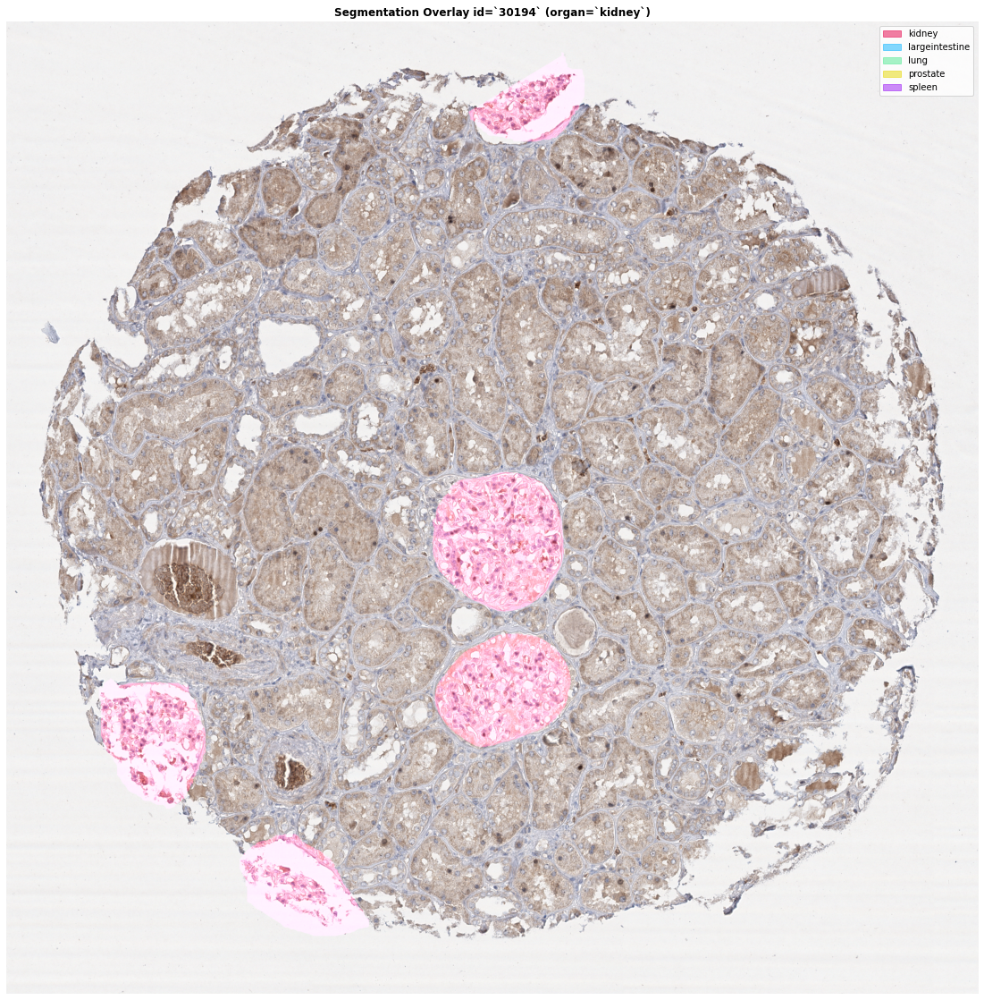



... SINGLE ID EXPLORATION FINISHED ...




... RANDOM LARGEINTESTINE TRAIN EXAMPLE ...



... NO ID GIVEN... RANDOM ID CHOSEN: ID=11890 ...

... ID (11890) EXPLORATION STARTED ...



... WITH id=`11890` (organ=`largeintestine`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,23
id,11890
organ,largeintestine
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,3000
img_width,3000
pixel_size,0.4
tissue_thickness,4
rle,1297230 32 1300222 46 1303215 60 1306213 63 13...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (largeintestine) ...



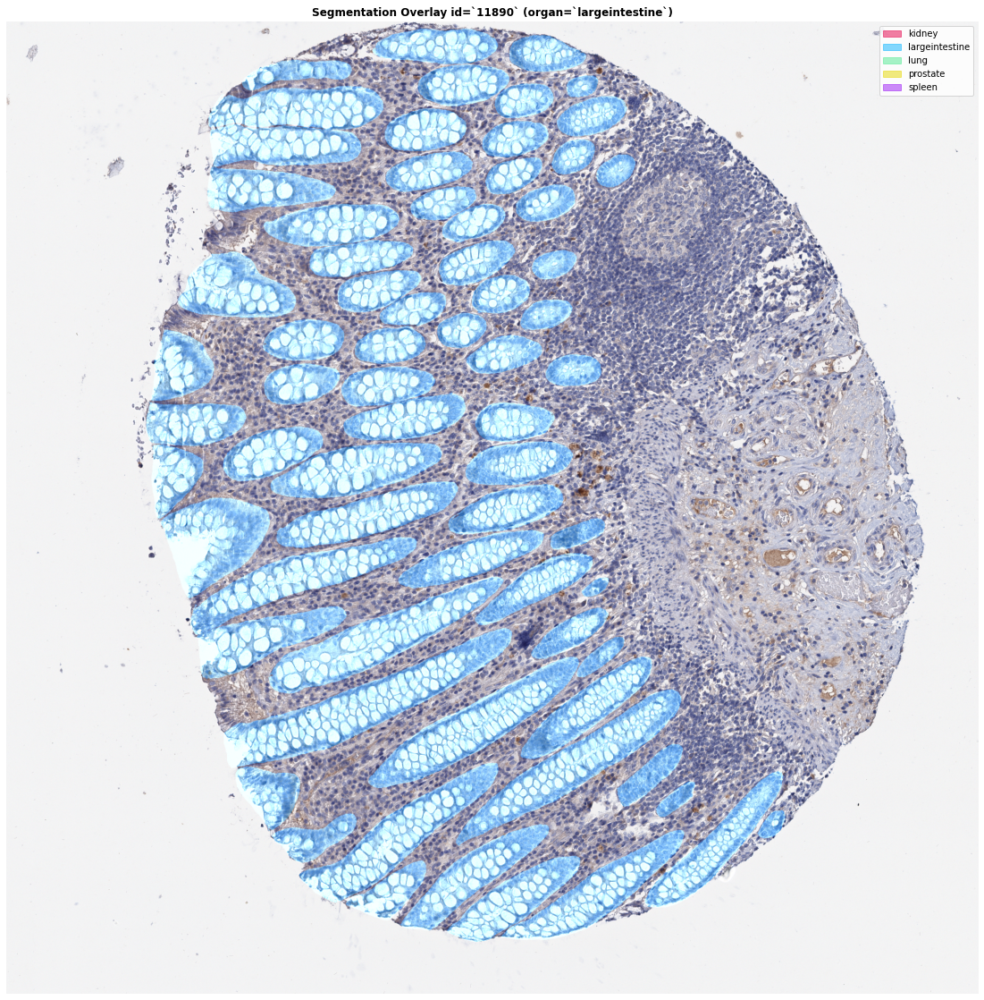



... SINGLE ID EXPLORATION FINISHED ...




... RANDOM LUNG TRAIN EXAMPLE ...



... NO ID GIVEN... RANDOM ID CHOSEN: ID=20563 ...

... ID (20563) EXPLORATION STARTED ...



... WITH id=`20563` (organ=`lung`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,113
id,20563
organ,lung
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,3000
img_width,3000
pixel_size,0.4
tissue_thickness,4
rle,3106494 3 3109492 8 3112491 7 3115490 16 31184...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (lung) ...



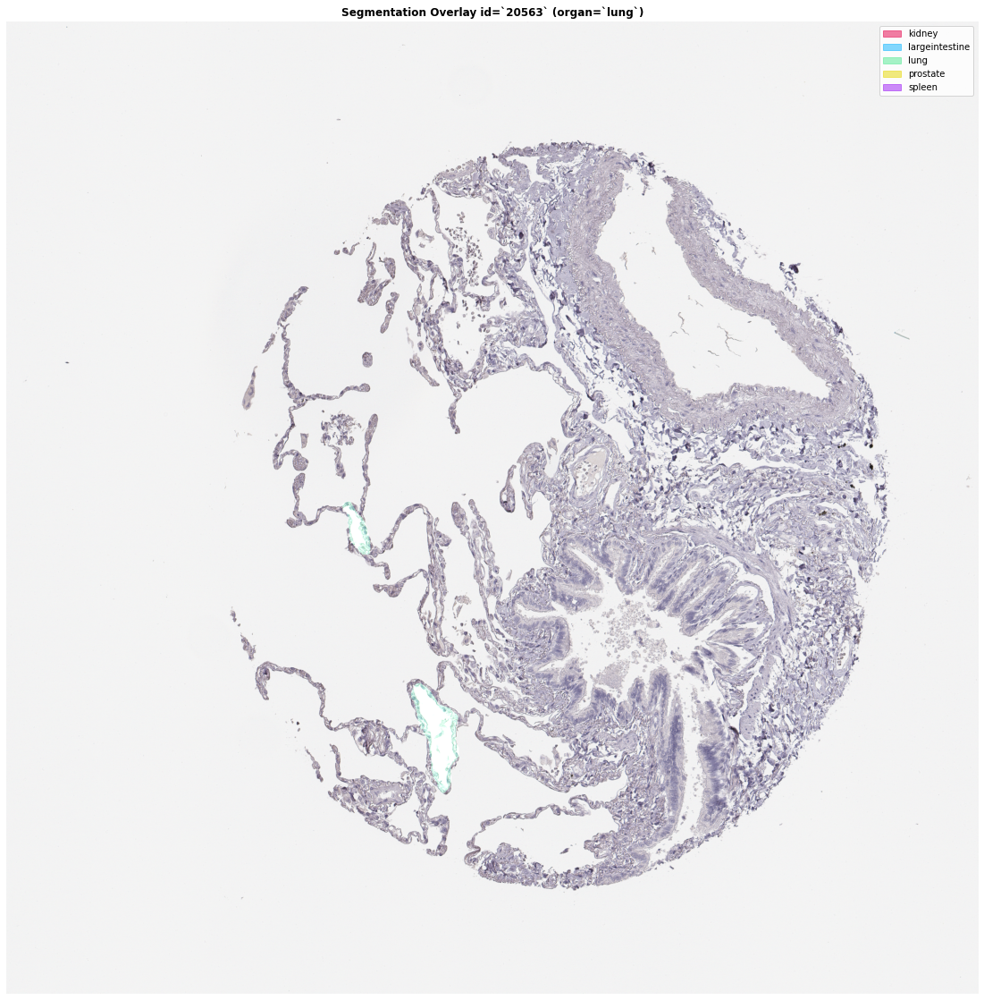



... SINGLE ID EXPLORATION FINISHED ...




... RANDOM PROSTATE TRAIN EXAMPLE ...



... NO ID GIVEN... RANDOM ID CHOSEN: ID=28318 ...

... ID (28318) EXPLORATION STARTED ...



... WITH id=`28318` (organ=`prostate`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,205
id,28318
organ,prostate
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,2869
img_width,2869
pixel_size,0.4
tissue_thickness,4
rle,322857 13 325718 38 328587 40 331447 57 334314...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (prostate) ...



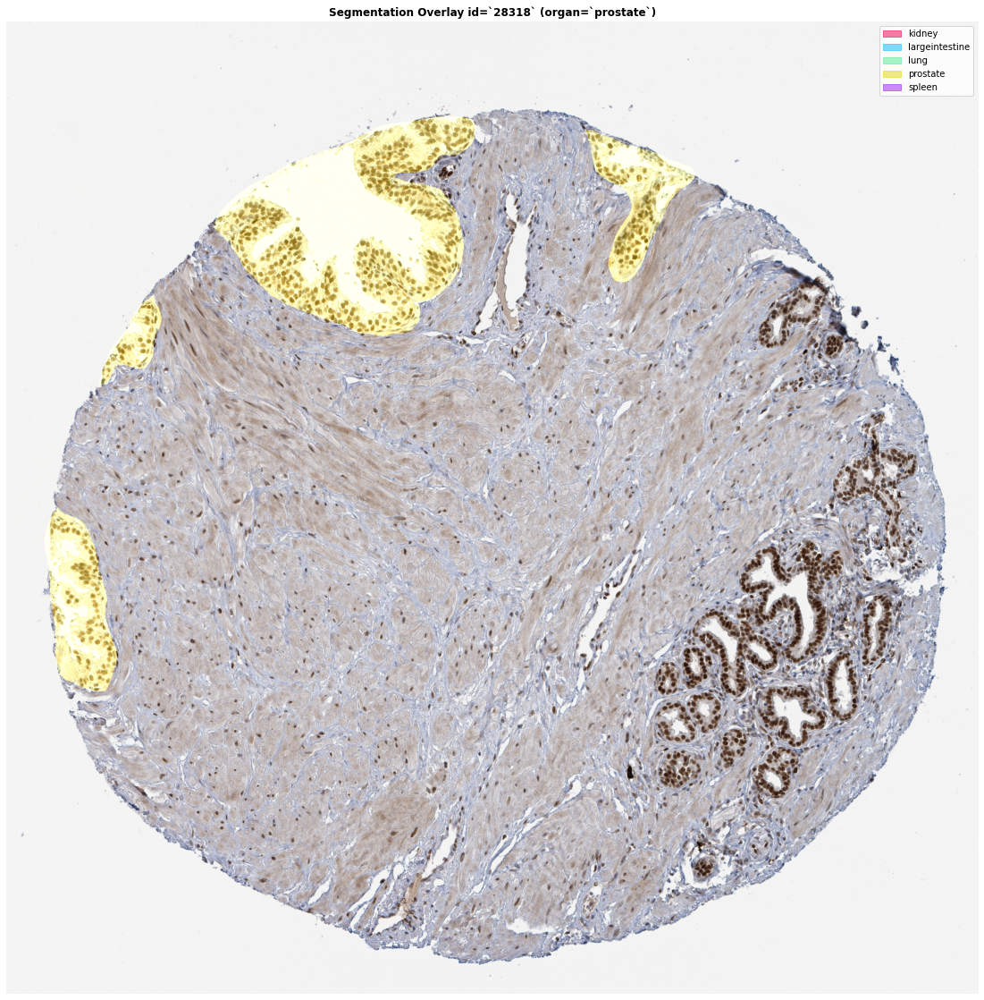



... SINGLE ID EXPLORATION FINISHED ...




... RANDOM SPLEEN TRAIN EXAMPLE ...



... NO ID GIVEN... RANDOM ID CHOSEN: ID=32231 ...

... ID (32231) EXPLORATION STARTED ...



... WITH id=`32231` (organ=`spleen`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,264
id,32231
organ,spleen
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,3000
img_width,3000
pixel_size,0.4
tissue_thickness,4
rle,1399958 26 1402957 29 1405956 32 1408947 48 14...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (spleen) ...



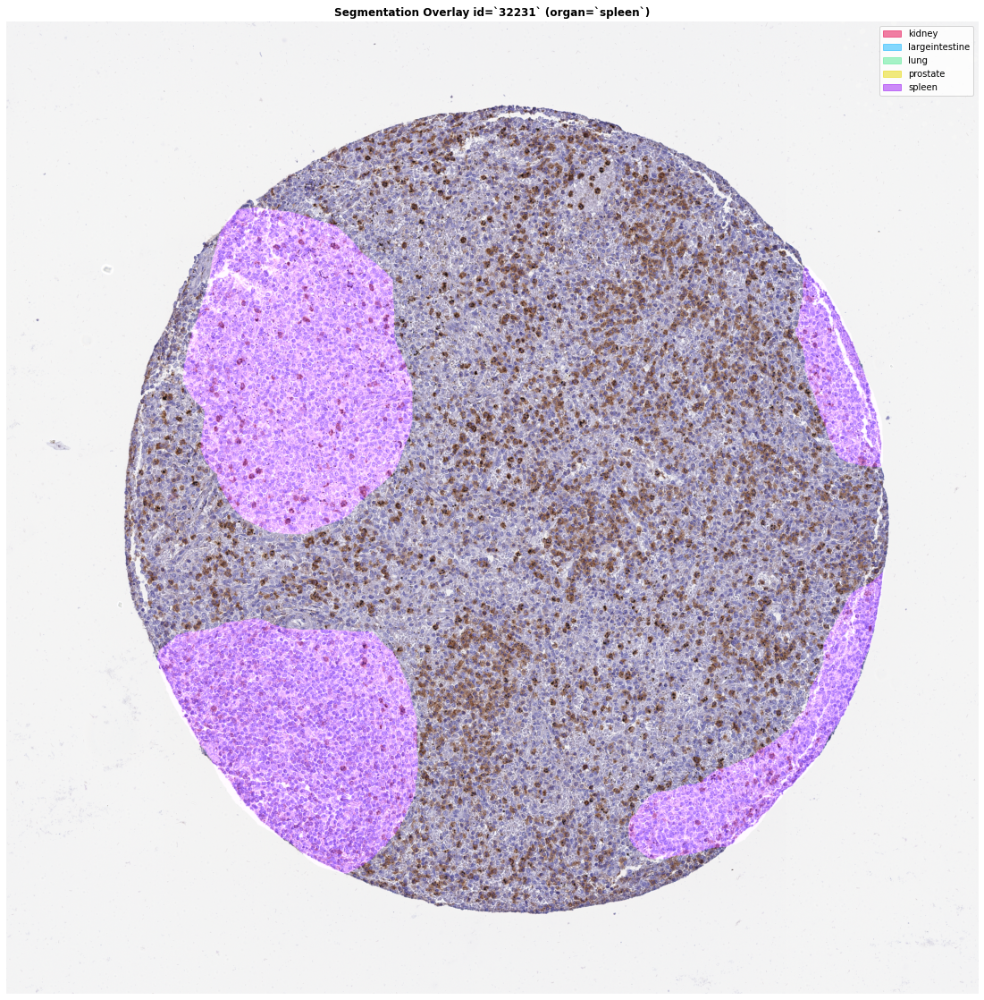



... SINGLE ID EXPLORATION FINISHED ...






... TEST IMAGE ...



... NO ID GIVEN... RANDOM ID CHOSEN: ID=10078 ...

... ID (10078) EXPLORATION STARTED ...



... WITH id=`10078` (organ=`spleen`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,0
id,10078
organ,spleen
data_source,Hubmap
img_path,/kaggle/input/hubmap-organ-segmentation/test_i...
img_height,2023
img_width,2023
pixel_size,0.4945
tissue_thickness,4




... ORIGINAL IMAGE PLOT ...



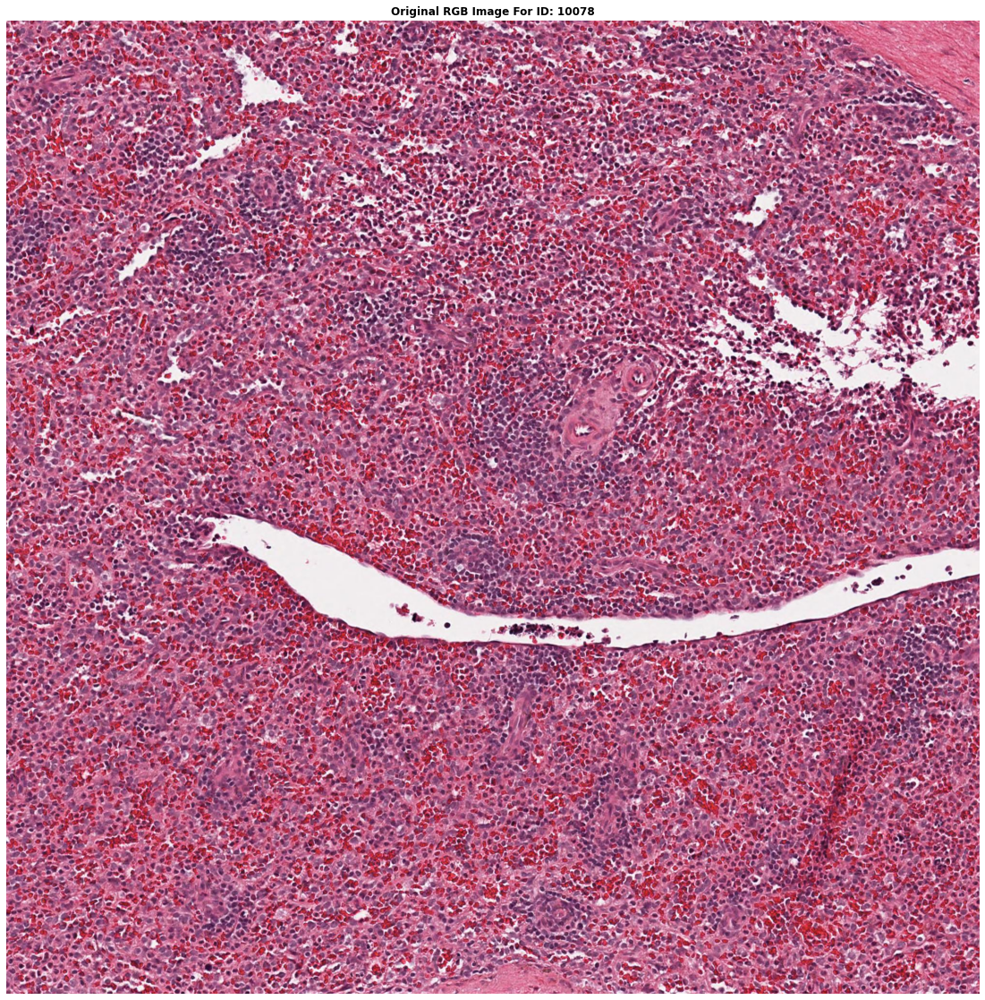



... SINGLE ID EXPLORATION FINISHED ...




In [7]:
for _o in ORGANS:
    print(f"\n\n... RANDOM {_o.upper()} TRAIN EXAMPLE ...\n\n")
    examine_id(train_df[train_df.organ==_o])

print("\n\n\n\n... TEST IMAGE ...\n\n")
examine_id(test_df, plot_overlay=False, plot_original=True)

In [8]:
train_df.img_width.value_counts()

3000    326
2631      2
2416      2
2942      2
2790      2
2764      2
2654      2
2539      1
2680      1
2727      1
2308      1
2867      1
2783      1
2869      1
2760      1
2630      1
2511      1
2593      1
2675      1
3070      1
Name: img_width, dtype: int64

# INVESTIGATE THE FREQUENCY OF VARIOUS ORGAN SEGMENTATION EXAMPLES

---

<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OBSERVATIONS</b>

We can observe the following distribution:
* **kidney**
    * **99** images
* **prostate**
    * **93** images
* **large intestine**
    * **58** images
* **spleen**
    * **53** images
* **lung**
    * **48** images
    
All of the organ types are represented fairly well within our data, with **kidney** and **prostate** being about twice as common as the other three organ types: **large intestine**, **spleen**, and **lung**

In [9]:
fig = px.histogram(train_df, "organ", color_discrete_map=O2C_HEX_MAP, color="organ", title="<b>Number of Segmentation Masks Per Organ Type</b>",)
fig.show()

# INVESTIGATE THE IMAGE SIZES

---

It's observable that not all images have the same size... however, given that, there is not that much variation between image sizes:

<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OBSERVATIONS</b>
* Globally, we can see that most of the images are dominated by a single size $(3000 \times 3000)$
* All the other sizes (19) only have 1 or 2 occurences each.
* All image sizes are square


<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OTHER INFORMATION</b>

* Expect roughly 550 images in the hidden test set. 
* All HPA images are 3000 x 3000 pixels with a tissue area within the image around 2500 x 2500 pixels. 
* The Hubmap images range in size from 4500x4500 down to 160x160 pixels.

<br>

In [10]:
fig = px.scatter(train_df.drop_duplicates(subset=["img_width", "img_height"]), x="img_width", y="img_height", 
                 size=train_df.groupby(["img_width", "img_height"])["id"].transform("count").iloc[train_df.drop_duplicates(subset=["img_width", "img_height"]).index], 
                 color="("+train_df.drop_duplicates(subset=["img_width", "img_height"])["img_width"].astype(str)+","+train_df.drop_duplicates(subset=["img_width", "img_height"])["img_height"].astype(str)+")", 
                 title="<b>Bubble Chart Showing The Various Image Sizes</b>",
                 labels={"color":"<b>Size Legend</b>", 
                         "size":"<b>Number Of Observations</b>",
                         "img_height":"<b>Image Height (pixels)</b>",
                         "img_width":"<b>Image Width (pixels)</b>"},
                 size_max=150)
fig.show()

# INVESTIGATE AGE

---

<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OBSERVATIONS</b>
* The age distribution is skewed to be 50+
* The distribution of examples with **large intestine** segmented is much higher among the oldest demographic
* The general distribution of organ segmentation types across age groups appears relatively stratified (with the previously noted exception)

<br>

In [11]:
fig = px.histogram(train_df, train_df["age"]*age_divisor, color_discrete_map=O2C_HEX_MAP, color="organ", 
                   title="<b>Number of Segmentation Masks Per Age Bin by Organ Type </b>",
                   labels={"organ":"<b>Organ Legend</b>", 
                         "count":"<b>Number Of Observations</b>",
                         "x":"<b>Age</b>"}, text_auto=True,
                  )
fig.show()

# INVESTIGATE SEX 

---

<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OBSERVATIONS</b>
* Women do not have a prostate and as such there are no prostate examples where gender is Female.
* Kidney's seem skewed towards the Male gender
* All other organ's appear evenly distributed

<br>

In [12]:
fig = px.histogram(train_df, train_df["sex"], color_discrete_map=O2C_HEX_MAP, color="organ", 
                   title="<b>Examples by Gender (0=Male, 1=Female) and Organ Type</b>",
                   labels={"organ":"<b>Organ Legend</b>", 
                         "count":"<b>Number Of Observations</b>",
                         "sex":"<b>Sex</b>"},text_auto=True, barmode="group",
                  )
fig.show()

# MASK AREA BY ORGAN

---

<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OBSERVATIONS</b>
* Kidney's are the smallest by total area but the FTUs are individually larger than the Lung FTUs
* Lung's are the next smallest by total area and have the second smallest average FTUs (more FTUs per image than Kidney)
* Spleen is the next smallest by total area... however they are the largest FTUs on average
* Prostate is the next largest and has the largest individual FTUs 
* Large Intestine constitutes the largest percentage of the respective images... however, they are actually the smallest FTUs on average individually.


... ID (5086) EXPLORATION STARTED ...



... WITH id=`5086` (organ=`lung`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,287
id,5086
organ,lung
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,3000
img_width,3000
pixel_size,0.4
tissue_thickness,4
rle,1510934 32 1513930 36 1516928 38 1519926 40 15...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (lung) ...



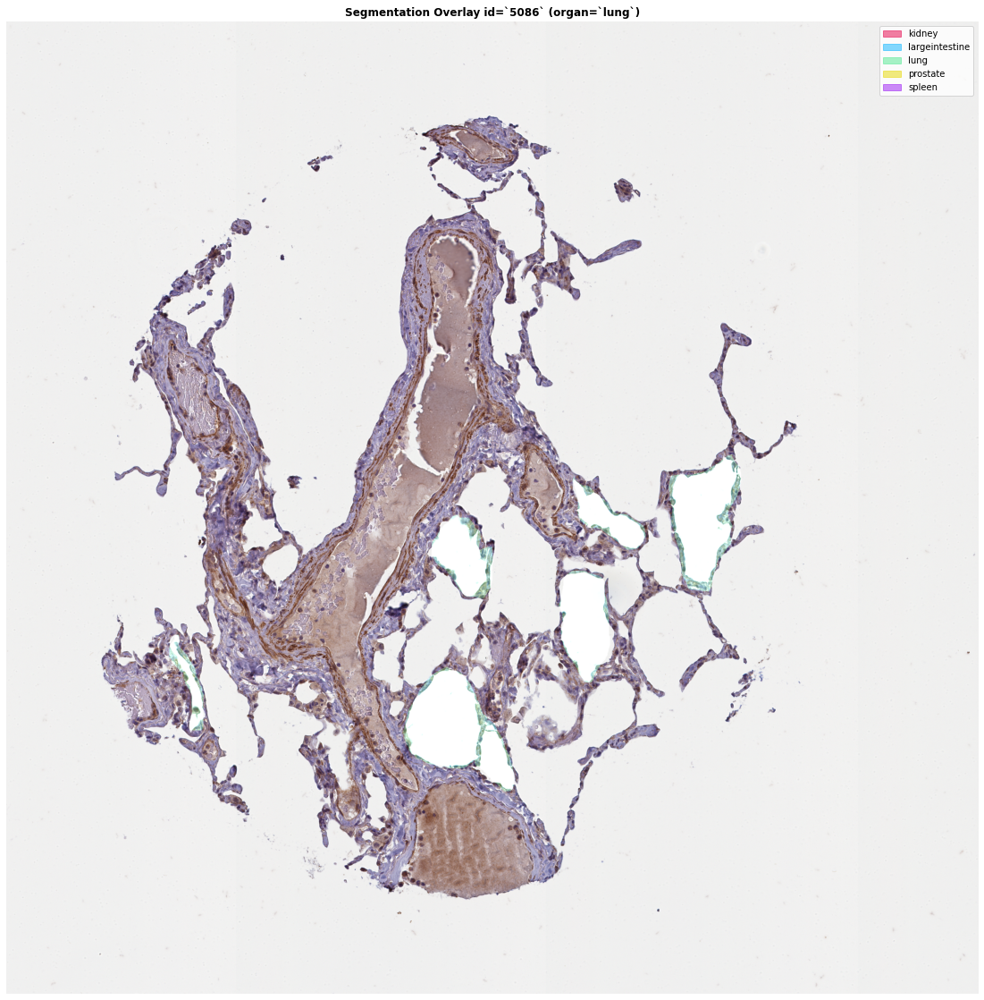



... SINGLE ID EXPLORATION FINISHED ...




In [13]:
examine_id(train_df, ex_id=train_df[train_df.organ=="lung"].id.sample(10).values[0])

In [14]:
train_df["mask_area_pct"] = train_df.rle.progress_apply(lambda x: rle_decode(x, (3000,3000)).sum()/(3000**2))

fig = px.histogram(train_df, "mask_area_pct", color="organ", title="<b>Mask Area Percentage By Organ Type</b>", color_discrete_map=O2C_HEX_MAP, barmode="group", nbins=10)
fig.show()

  0%|          | 0/351 [00:00<?, ?it/s]

# WHY DO WE HAVE JSON FILES AND RLE?

---

<br><b style="text-decoration: underline; font-family: Verdana; text-transform: uppercase;">OBSERVATIONS</b>
* The RLE is the entire binary mask as a simple compressed string
* The JSON contains the description of the masks as a collection (list) of polygons representing the respective masks.
    * A polygon is represented as a collection (list) of vertices.
    * A vertex is a point represented by a pair of values –– the x,y position
    * If you took these polygons and plotted them alongside the RLE decoded mask, they SHOULD be the same. I think it's simply another representation for us to use.

<b>NOTE: The RLE is more accurate than the Polygon Mask and should be used.</b>

<br>




... First – Plot the image and the RLE overlapped ontop ...


... NO ID GIVEN... RANDOM ID CHOSEN: ID=10044 ...

... ID (10044) EXPLORATION STARTED ...



... WITH id=`10044` (organ=`prostate`)  –  WE HAVE THE FOLLOWING DEMO EXAMPLE TO WORK FROM ... 




,0
id,10044
organ,prostate
data_source,HPA
img_path,/kaggle/input/hubmap-organ-segmentation/train_...
lbl_path,/kaggle/input/hubmap-organ-segmentation/train_...
img_height,3000
img_width,3000
pixel_size,0.4
tissue_thickness,4
rle,1459676 77 1462675 82 1465674 87 1468673 92 14...




... IMAGE WITH RGB SEGMENTATION MASK OVERLAY (prostate) ...



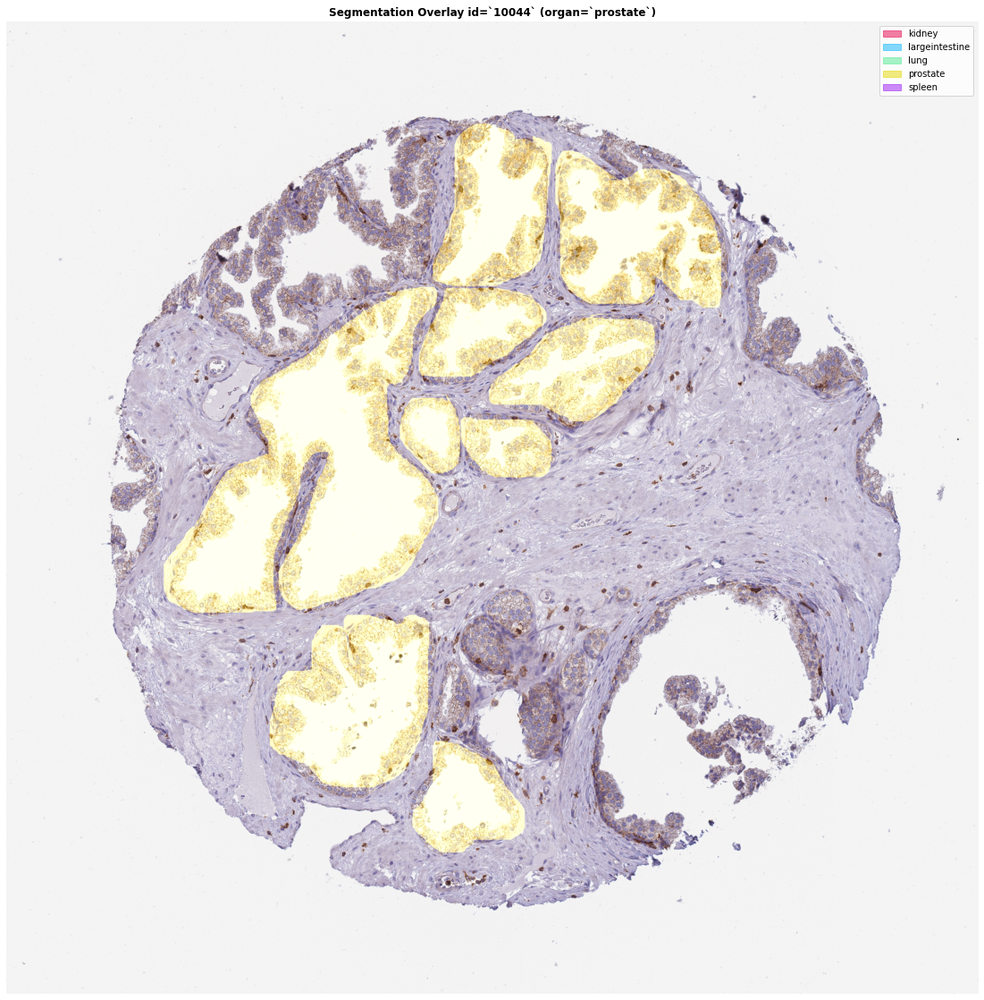



... SINGLE ID EXPLORATION FINISHED ...





... Second – Load the .json file and display mask polygons ...



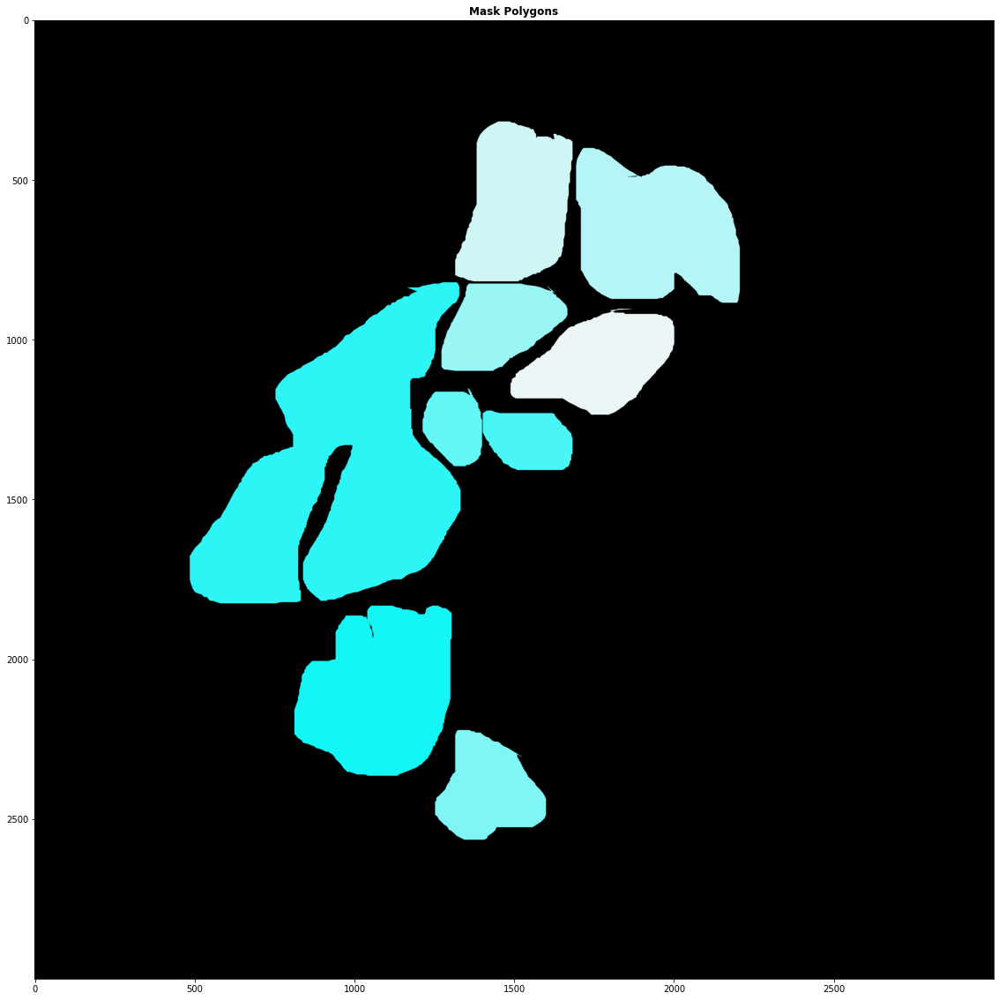




 Lastly – Compare mask polygons to rle decoded mask


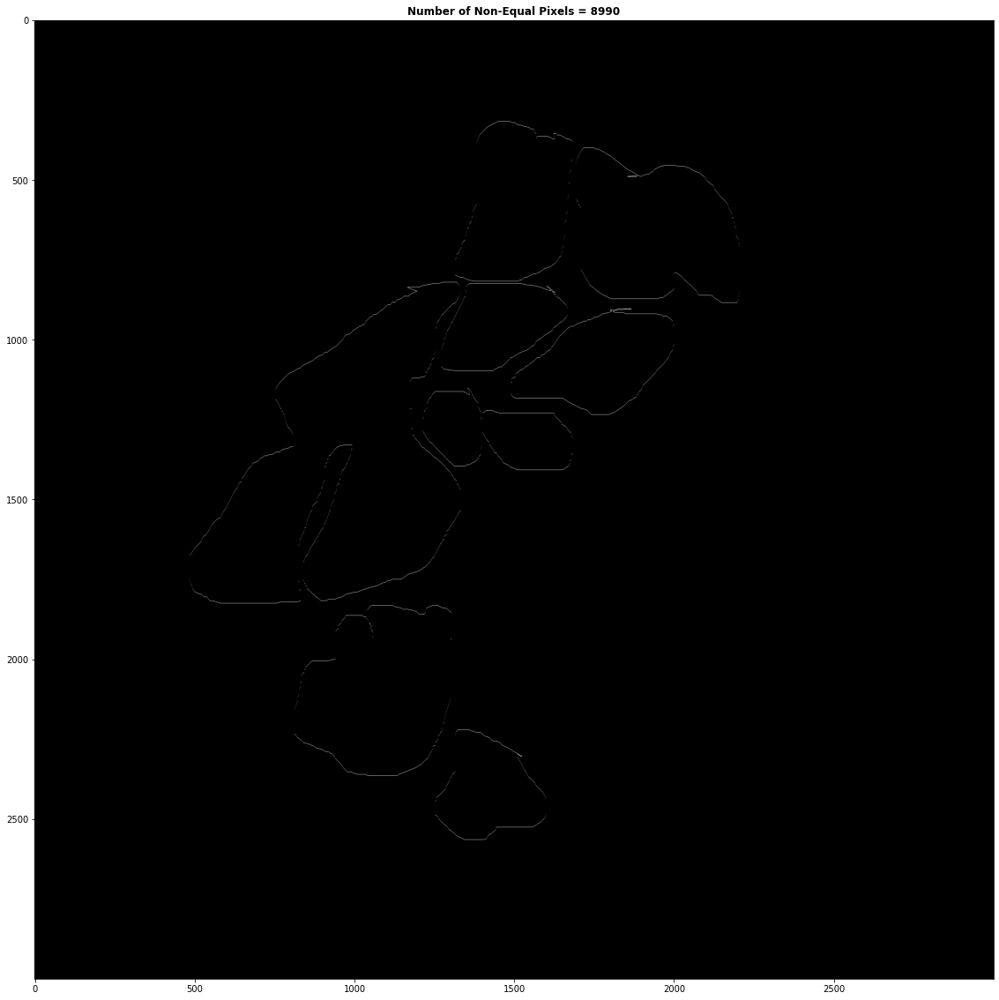

In [15]:
# Use first row as example --> ex_id=10044
ex_row = train_df[train_df.id==10044]

print("\n... First – Plot the image and the RLE overlapped ontop ...\n")
examine_id(ex_row)

print("\n\n\n... Second – Load the .json file and display mask polygons ...\n")
ex_poly = load_json_to_dict(ex_row.lbl_path.values[0])
raw_img = np.array(cv2.imread(ex_row.img_path[0])[..., ::-1])
img = np.zeros_like(raw_img)
color_space = np.linspace(235, 20, len(ex_poly), dtype=int)
for i, ex_p in enumerate(ex_poly):
    img = cv2.fillPoly(img, [np.expand_dims(np.array(ex_p, np.int32), axis=0)], color=(int(color_space[i]),245,245))
plt.figure(figsize=(20,20))
plt.title("Mask Polygons", fontweight="bold")
plt.imshow(img)
plt.show()

print("\n\n\n Lastly – Compare mask polygons to rle decoded mask")
rle_mask = rle_decode(ex_row.rle.values[0], (ex_row.img_width.values[0], ex_row.img_height.values[0]))
json_mask = np.where(img>0, 1, 0)[..., 0].astype(np.float32)
diff_mask = np.abs(rle_mask-json_mask).astype(np.uint8)

plt.figure(figsize=(20,20))
plt.title(f"Number of Non-Equal Pixels = {(rle_mask!=json_mask).sum()}", fontweight="bold")
plt.imshow(diff_mask, cmap="gray")
plt.show()

**VISUALIZE DAB STAIN AND HEMATOXYLIN COUNTERSTAIN**
* DAB is brown and present at locations of enzymatic activity
* HEMATOXYLIN is light blue when found within cells
* HEMATOXYLIN is dark blue when found within nuclei

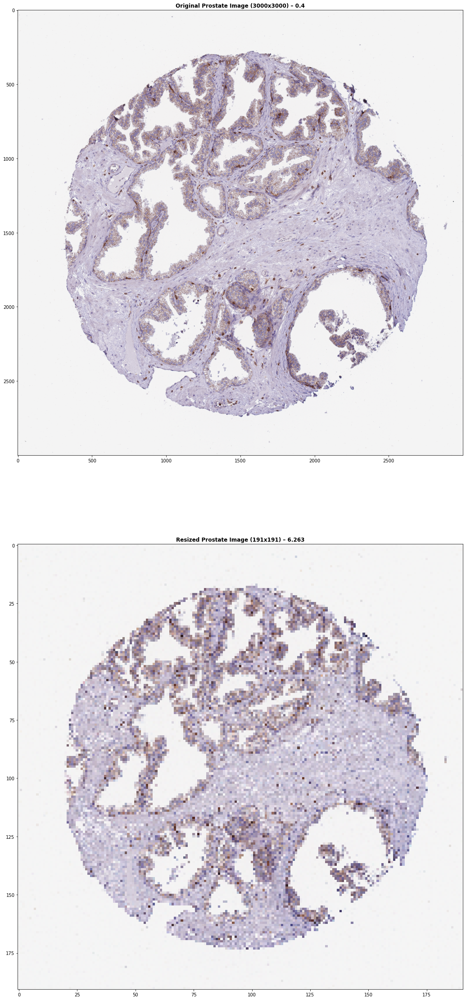

In [16]:
original_prostate_img = cv2.imread(train_df.img_path[0])[..., ::-1]
resized_prostate_img = cv2.resize(original_prostate_img, (int(3000*(0.4/6.263)),int(3000*(0.4/6.263))))

plt.figure(figsize=(20,40))

plt.subplot(2,1,1)
plt.imshow(original_prostate_img)
plt.title("Original Prostate Image (3000x3000) – 0.4", fontweight="bold")

plt.subplot(2,1,2)
plt.imshow(resized_prostate_img)
plt.title("Resized Prostate Image (191x191) – 6.263", fontweight="bold")

plt.savefig("comparison.png", dpi=300)
plt.show()

# RELATED WORK

---

* Leah L. Godwin, Yingnan Ju, Naveksha Sood, Yashvardhan Jain, Ellen M. Quardokus, Andreas Bueckle, Teri Longacre, Aaron Horning, Yiing Lin, Edward D. Esplin, John W. Hickey, Michael P. Snyder, N. Heath Patterson, Jeffrey M. Spraggins, Katy Börner. “Robust and generalizable segmentation of human functional tissue units”; bioRxiv 2021.11.09.467810; doi: https://doi.org/10.1101/2021.11.09.467810
* Sheehan, Susan M., and Ron Korstanje. 2018. “Automatic Glomerular Identification and Quantification of Histological Phenotypes Using Image Analysis and Machine Learning.” American Journal of Physiology - Renal Physiology 315 (6): F1644–51. https://doi.org/10.1152/ajprenal.00629.2017.
* Gallego, Jaime, Anibal Pedraza, Samuel Lopez, Georg Steiner, Lucia Gonzalez, Arvydas Laurinavicius, and Gloria Bueno. 2018. “Glomerulus Classification and Detection Based on Convolutional Neural Networks.” Journal of Imaging 4 (1): 20. https://doi.org/10.3390/jimaging4010020.
* Govind, Darshana, Brandon Ginley, Brendon Lutnick, John E. Tomaszewski, and Pinaki Sarder. 2018. “Glomerular Detection and Segmentation from Multimodal Microscopy Images Using a Butterworth Band-Pass Filter.” In Medical Imaging 2018: Digital Pathology, 10581:1058114. International Society for Optics and Photonics. https://doi.org/10.1117/12.2295446.
* Bukowy, John D., Alex Dayton, Dustin Cloutier, Anna D. Manis, Alexander Staruschenko, Julian H. Lombard, Leah C. Solberg Woods, Daniel A. Beard, and Allen W. Cowley. 2018. “Region-Based Convolutional Neural Nets for Localization of Glomeruli in Trichrome-Stained Whole Kidney Sections.” Journal of the American Society of Nephrology 29 (8): 2081–88. https://doi.org/10.1681/ASN.2017111210.
* Kannan, Shruti, Laura A. Morgan, Benjamin Liang, McKenzie G. Cheung, Christopher Q. Lin, Dan Mun, Ralph G. Nader, et al. 2019. “Segmentation of Glomeruli Within Trichrome Images Using Deep Learning.” Kidney International Reports 4 (7): 955–62. https://doi.org/10.1016/j.ekir.2019.04.008.
* Nassim Bouteldja, Barbara M. Klinkhammer, Roman D. Bülow, Patrick Droste, Simon W. Otten, Saskia Freifrau von Stillfried, Julia Moellmann, Susan M. Sheehan, Ron Korstanje, Sylvia Menzel, Peter Bankhead, Matthias Mietsch, Charis Drummer, Michael Lehrke, Rafael Kramann, Jürgen Floege, Peter Boor, Dorit Merhof. “Deep Learning–Based Segmentation and Quantification in Experimental Kidney Histopathology”; JASN Jan 2021 32 (1) 52-68; https://doi.org/10.1681/ASN.2020050597
* Brandon Ginley, Brendon Lutnick, Kuang-Yu Jen, Agnes B. Fogo, Sanjay Jain, Avi Rosenberg, Vighnesh Walavalkar, Gregory Wilding, John E. Tomaszewski, Rabi Yacoub, Giovanni Maria Rossi, Pinaki Sarder.“Computational Segmentation and Classification of Diabetic Glomerulosclerosis”; JASN Oct 2019, 30 (10) 1953-1967; https://doi.org/10.1681/ASN.2018121259